#  🔎 Exploring Graz's trees distribution in Urban Green Spaces

This exercise will help you understand how to gather, process, analyze, and visualize geospatial data to gain insights into urban environments.

## 1. Contextualization

**Urban Green Spaces**: Urban green spaces such as parks, gardens, recreational areas, and tree-lined streets are vital for maintaining livable urban environments. They offer numerous benefits:

- _Environmental_: Improve air quality, regulate temperatures, reduce urban heat island effect.
- _Social_: Provide spaces for recreation, social interaction, and enhance aesthetic appeal.
- _Ecological_: Support biodiversity and provide habitats for various species.


**Urban Trees**: Trees within these green spaces play a crucial role by:

- Offering shade and reducing energy consumption.
- Enhancing biodiversity.
- Contributing to the overall sustainability and livability of the city.

> <span style='background:red'> 🎯 **Objective:** <span>
> 1. **Explore the spatial distribution of green spaces and trees in Graz**: Explore the spatial distribution of green spaces and trees in Graz, identifying the relationship between tree locations and various types of green areas.
> 2. **Equitable Distribution of Tree Cover**: Assess whether tree cover is proportionally distributed across different green spaces to ensure all city residents benefit from their environmental and aesthetic advantages.

This analysis will provide a comprehensive understanding of how urban green spaces and trees are distributed across Graz and their potential impact on the city’s sustainability and livability.

---

## 2. Data Gathering

**OpenStreetMap (OSM)**: Provides comprehensive geospatial data on urban features, including green spaces and trees.

In [1]:
# import libraries
import numpy as np
import geopandas as gpd
import osmnx as ox
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import folium
from folium.plugins import MarkerCluster
from keplergl import KeplerGl

> <span style='background:yellow'>💡 **Technical Tips:** <span>
>
> **Installing Missing Libraries**: If a library is missing, install it using `!pip install LIB_NAME`.
> **Persisting Changes**: To make library installations permanent, add them to your `requirements.txt` and rebuild your Docker image.

#### Step 1️⃣: Define the Study Area

In [2]:
# select a city
city_name = "Graz, Austria"

> <span style='background:lightblue'>ℹ️ **Information:**</span>
>
> OSMnx is a powerful Python package for working with street networks and other geospatial data from OpenStreetMap
> To download data from OSM you can use the function `features_from_place`, which takes a place name. You can pull OSM data from a point + distance or address + distance, or from a polygon/bbox

#### Step 2️⃣: Download City Boundary

In [3]:
gdf_city_boundary = ox.geocode_to_gdf(city_name)

#### Step 3️⃣: Download Green Spaces

In [4]:
# define OSM tags for green spaces
green_space_osmtags = {
    'leisure': ['park', 'pitch', 'garden', 'recreation_ground', 'golf_course', 'dog_park'],
    'landuse': ['grass', 'forest', 'meadow', 'farmland', 'village_green', 'flowerbed', 'allotments', 'cemetery', 'greenfield', 'recreation_ground'],
    'natural': ['wood', 'scrub', 'grassland', 'shrubbery', 'meadow'],
    'boundary': ['protected_area', 'forest', 'national_park']
}

# fetch green spaces
gdf_green_spaces = ox.features_from_place(city_name, green_space_osmtags)

#### Step 4️⃣: Download Urban Trees

In [5]:
# define osm tags for trees
trees_osmtags = {
    'natural': ['tree']
}

# fetch trees
gdf_trees = ox.features_from_place(city_name, trees_osmtags)

#### Step 5️⃣: Visualize downloaded data

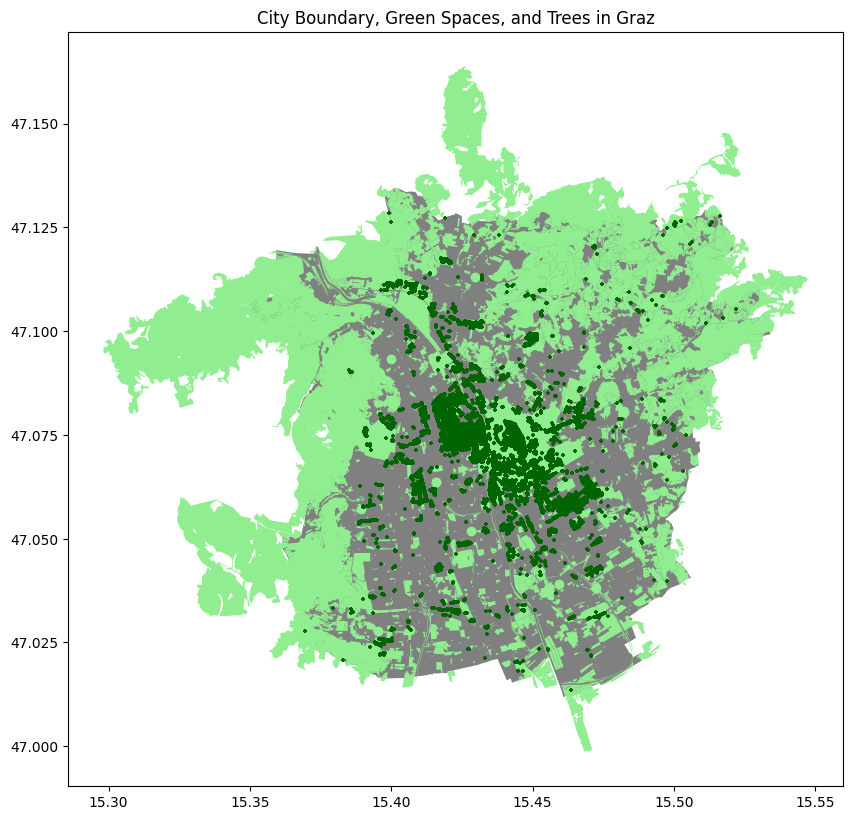

In [6]:
# plot city boundary, green spaces, and urban trees:
fig, ax = plt.subplots(figsize=(10, 10))
gdf_city_boundary.plot(ax=ax, color='grey')
gdf_green_spaces.plot(ax=ax, color='lightgreen')
gdf_trees.plot(ax=ax, marker='+', color='darkgreen', markersize=5)
plt.title("City Boundary, Green Spaces, and Trees in Graz")
plt.show()

---

## 3. Data Preparation

**Importance**: Data preparation ensures that the data is clean, consistent, and ready for analysis.

#### Step 1️⃣: Data Integrity

> <span style='background:lightblue'>ℹ️ **Information:**</span>
>
> OpenStreetMap (OSM) uses three fundamental elements to represent geographic data: nodes, ways, and relations.
> see documentation [here](https://wiki.openstreetmap.org/wiki/Elements)

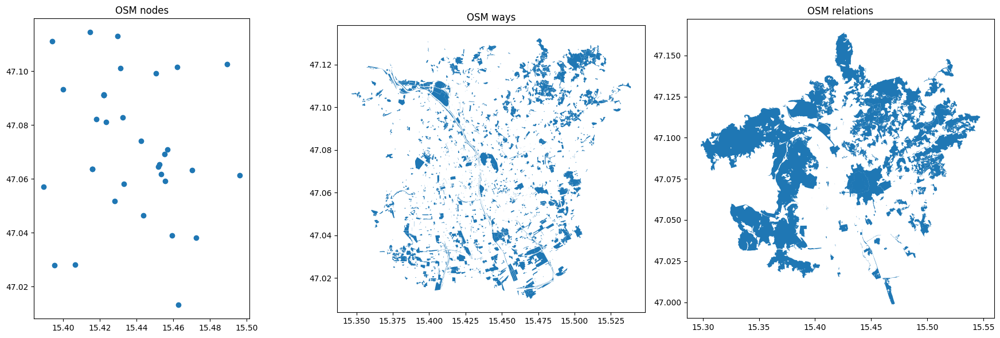

In [7]:
# Create a figure with 1 row and 3 columns
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot 1: nodes
# You can inspect multiple layers indexes by using the following code
gdf_green_spaces[np.in1d(gdf_green_spaces.index.get_level_values(0), ['node'])].plot(ax=axes[0])
axes[0].set_title("OSM nodes")

# Plot 2: ways
gdf_green_spaces[np.in1d(gdf_green_spaces.index.get_level_values(0), ['way'])].plot(ax=axes[1])
axes[1].set_title("OSM ways")

# Plot 3: relation
gdf_green_spaces[np.in1d(gdf_green_spaces.index.get_level_values(0), ['relation'])].plot(ax=axes[2])
axes[2].set_title("OSM relations")

# Adjust layout to avoid overlap
plt.tight_layout()

# Display the plots
plt.show()

In [8]:
# remove point geometries from green spaces:
gdf_green_spaces = gdf_green_spaces[gdf_green_spaces.geometry.type != 'Point']

#### Step 2️⃣: Coordinate Reference System (CRS) Consistency

In [9]:
print(gdf_city_boundary.crs)
print(gdf_green_spaces.crs)
print(gdf_trees.crs)

epsg:4326
epsg:4326
epsg:4326


#### Step 3️⃣: Clip the Data to the Study Area

<Axes: >

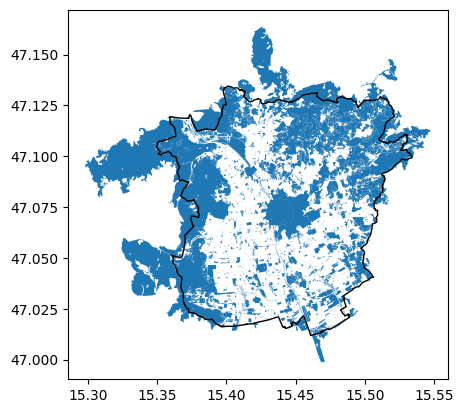

In [10]:
# let's plot the the green spaces and the city boundaries
base = gdf_green_spaces.plot()
gdf_city_boundary.plot(ax=base, facecolor='none', edgecolor='black')

<Axes: >

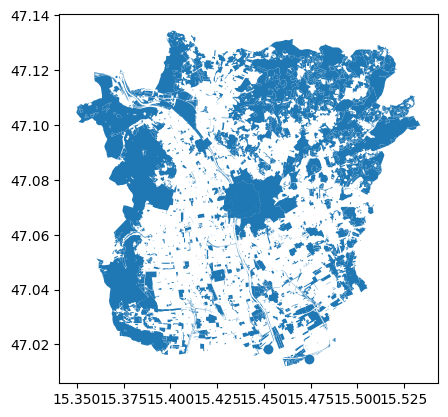

In [11]:
# need to keep only the green spaces within the city boundary
gdf_graz_green_spaces = gpd.clip(gdf_green_spaces, gdf_city_boundary)
gdf_graz_trees = gpd.clip(gdf_trees, gdf_city_boundary)

gdf_graz_green_spaces.plot()

#### Step 4️⃣: Attribute Cleaning and grouping

In [12]:
# reset the indexes
gdf_city_boundary = gdf_city_boundary.reset_index()
gdf_graz_green_spaces = gdf_graz_green_spaces.reset_index()
gdf_trees = gdf_trees.reset_index()

In [13]:
# consolidate OSM tags into a single attribute (landuse_filled)
osm_to_landuse = {
    'scrub': 'meadow',
    'wood': 'forest',
    'grassland': 'grass',
    'heath': 'meadow',
    'water': '',
    'protected_area': 'meadow',
    'pitch': 'recreation_ground',
    'garden': 'village_green',
    'park': 'recreational_area',
    'dog_park': 'recreational_area',
    'golf_course': 'recreational_area',
    'nature_reserve': 'meadow',
    'water_park': 'recreational_area',
    'sports_centre': 'recreational_area',
    'horse_riding': 'recreational_area',
}

# map and fill `landuse_filled`
gdf_graz_green_spaces['landuse_filled'] = gdf_graz_green_spaces['landuse'].fillna(
    gdf_graz_green_spaces['natural'].map(osm_to_landuse)
).fillna(
    gdf_graz_green_spaces['boundary'].map(osm_to_landuse)
).fillna(
    gdf_graz_green_spaces['leisure'].map(osm_to_landuse)
).fillna('other')

# remove entries with empty `landuse_filled`
gdf_graz_green_spaces = gdf_graz_green_spaces[gdf_graz_green_spaces.landuse_filled != '']

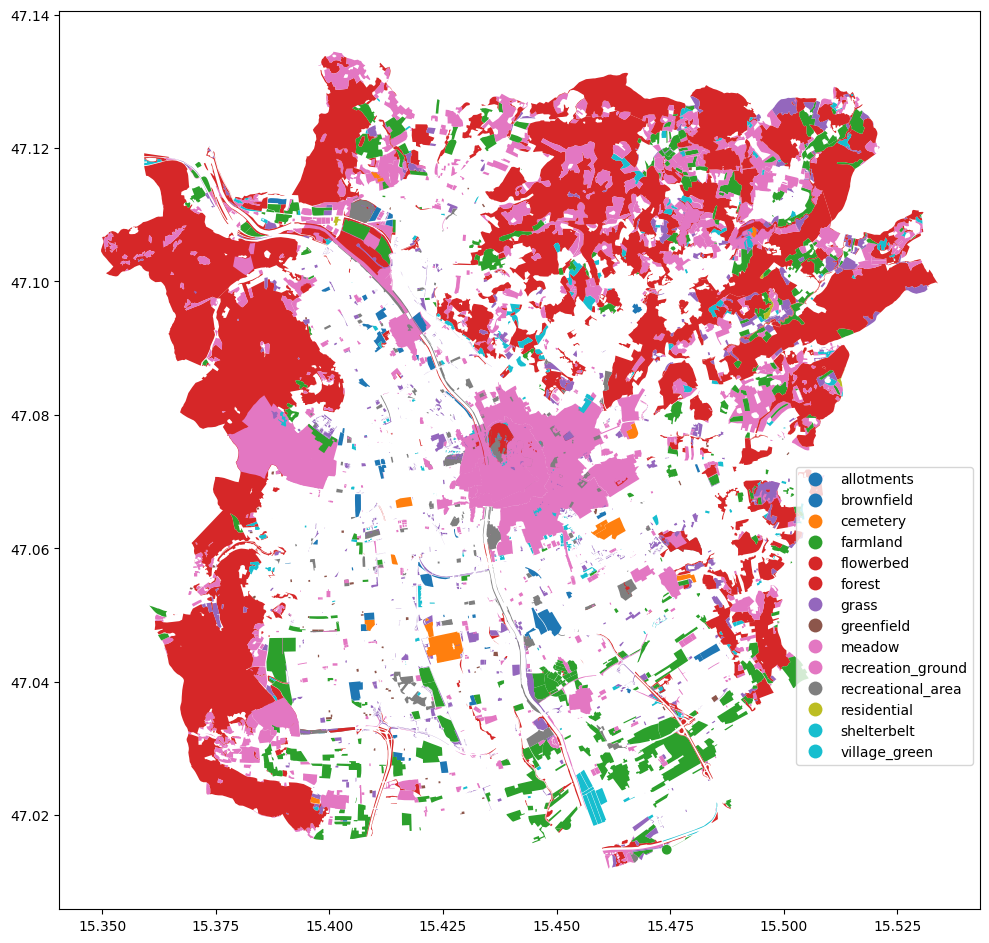

In [14]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

gdf_graz_green_spaces.plot(ax=ax, column="landuse_filled", categorical=True, legend=True, missing_kwds={'color': 'lightgrey'})
# Move the legend to the right side of the plot
legend = ax.get_legend()
legend.set_bbox_to_anchor((1, 0.5))  # Adjust the location of the legend (right side, center vertically)

plt.tight_layout()
plt.show()

---

## 4. Data Analysis

🎯 **Objectives**:

- Count Trees within Each Green Space Type
- Assess Equitable Distribution

⚙️ **Key Operations:**

- Buffer: create a geometry for the trees
- Intersection: Find which trees fall within green areas.
- Groupby and Count: Count the number of trees within and outside green spaces.
- Visualisation: Create a heatmap of tree locations and green spaces.

#### Step 1️⃣: Buffer Trees to Account for Spatial Imprecision

In [15]:
buffer_distance = 5  # meters
gdf_graz_trees = gdf_graz_trees.to_crs(epsg=3857)
gdf_graz_trees['geometry_buffered'] = gdf_graz_trees.geometry.buffer(buffer_distance)
gdf_graz_trees = gdf_graz_trees.to_crs(epsg=4326)

#### Step 2️⃣: Merge Green Spaces by Land Use Type

In [16]:
gdf_unified_green_places = gdf_graz_green_spaces.groupby('landuse_filled')['geometry'].apply(unary_union).reset_index()
gdf_unified_green_places.set_crs(epsg=4326, inplace=True)

,landuse_filled,geometry
0,allotments,"MULTIPOLYGON (((15.40293 47.01923, 15.40388 47..."
1,brownfield,"POLYGON ((15.40515 47.05714, 15.40525 47.05669..."
2,cemetery,"MULTIPOLYGON (((15.39753 47.02243, 15.39787 47..."
3,farmland,"GEOMETRYCOLLECTION (POINT (15.47424 47.01479),..."
4,flowerbed,"MULTIPOLYGON (((15.40988 47.03899, 15.40980 47..."
5,forest,GEOMETRYCOLLECTION (POLYGON ((15.37294 47.0231...
6,grass,"MULTIPOLYGON (((15.39103 47.02014, 15.39098 47..."
7,greenfield,"MULTIPOLYGON (((15.39922 47.03464, 15.40030 47..."
8,meadow,GEOMETRYCOLLECTION (POLYGON ((15.37321 47.0247...
9,recreation_ground,"MULTIPOLYGON (((15.39719 47.02499, 15.39717 47..."


#### Step 3️⃣: Spatial Join, Count Trees within Each Land Cover Category

In [19]:
gdf_trees_with_landuse = gpd.sjoin(gdf_graz_trees.set_geometry('geometry_buffered').to_crs(epsg=4326), 
                               gdf_unified_green_places, 
                               how='left', 
                               predicate='intersects')
gdf_trees_with_landuse['landuse_filled'] = gdf_trees_with_landuse['landuse_filled'].fillna('unclassified')

#### Step 4️⃣: Aggregate Tree Counts by Land Use Type

In [20]:
tree_counts = gdf_trees_with_landuse.groupby('landuse_filled').size().reset_index(name='tree_count')
gdf_green_spaces_trees_count = gdf_unified_green_places.merge(tree_counts, on='landuse_filled', how='left').fillna({'tree_count': 0})

## 5. Communication

**Data Visualisation**: Visualise the data to communicate results effectively. Emphasise tree locations within green spaces and total shading areas.

#### Step 1️⃣: Map Visualization

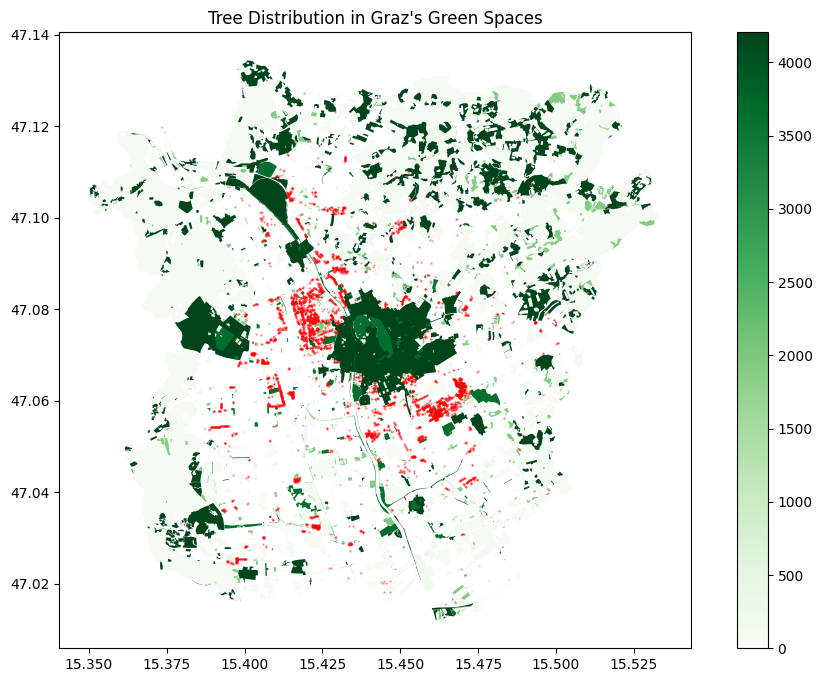

In [21]:
fig, ax = plt.subplots(figsize=(12, 8))
gdf_green_spaces_trees_count.plot(ax=ax, column='tree_count', legend=True, cmap='Greens')
gdf_trees_with_landuse.set_geometry('geometry').query("landuse_filled == 'unclassified'").plot(ax=ax, marker='.', color='red', markersize=1, alpha=0.5)
plt.title("Tree Distribution in Graz's Green Spaces")
plt.show()

#### Step 2️⃣: Bar Chart of Tree Counts by Land Use Type

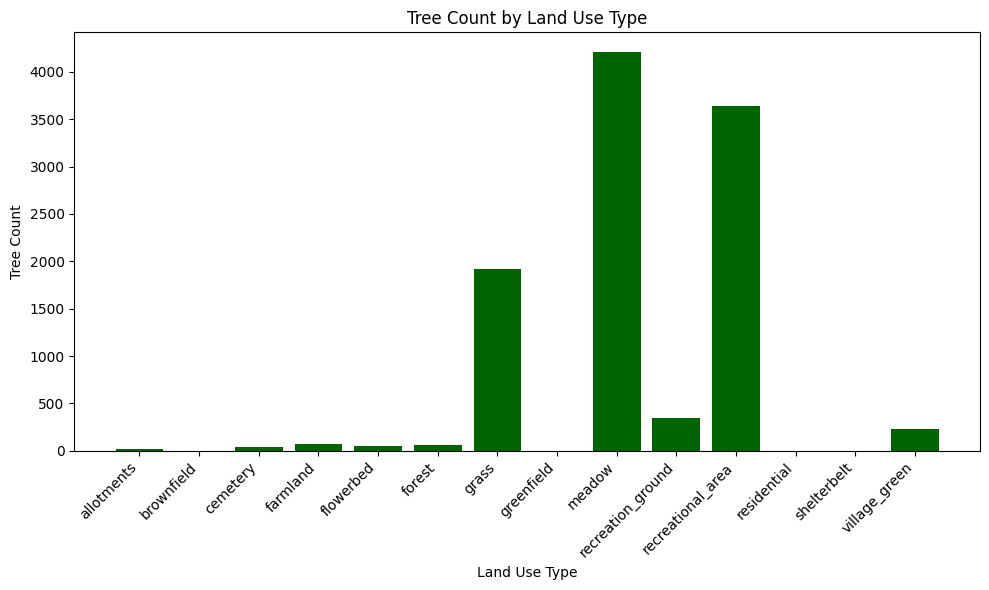

In [22]:
plt.figure(figsize=(10, 6))
plt.bar(gdf_green_spaces_trees_count['landuse_filled'], gdf_green_spaces_trees_count['tree_count'], color='darkgreen')
plt.title('Tree Count by Land Use Type')
plt.xlabel('Land Use Type')
plt.ylabel('Tree Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### Step 3️⃣: Interactive Folium Map

In [24]:
centroid = gdf_city_boundary.geometry.centroid.iloc[0]
map_center = [centroid.y, centroid.x]

m = folium.Map(location=map_center, zoom_start=13, tiles='cartodbpositron')

for _, row in gdf_trees_with_landuse.iterrows():
    landuse = row['landuse_filled']
    popup_text = f"Land Use: {landuse}"
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=3,
        color='green' if landuse != 'unclassified' else 'red',
        fill=True,
        fill_color='green' if landuse != 'unclassified' else 'red',
        fill_opacity=0.7,
        popup=popup_text
    ).add_to(m)

m

/tmp/ipykernel_91/3086643493.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroid = gdf_city_boundary.geometry.centroid.iloc[0]


#### Step 4️⃣: GeoJSON Export

In [25]:
# you can export your data as geojson to use it in another software
gdf_green_spaces_trees_count.to_file("Trees_count_in_green_spaces.geojson", driver="GeoJSON")

#### Step 5️⃣: Export to html with KeplerGL

In [61]:
gdf_trees_with_landuse

geometry     landuse_filled
element_type osmid                                                   
node         2727921867  POINT (15.46361 47.01365)       unclassified
             7435653059  POINT (15.46283 47.03072)  recreational_area
             7435653058  POINT (15.46293 47.03075)  recreational_area
             7435653057  POINT (15.46312 47.03081)  recreational_area
             7435653056  POINT (15.46330 47.03086)  recreational_area
...                                            ...                ...
             4490748008  POINT (15.40259 47.11197)             meadow
             4490748013  POINT (15.40255 47.11205)             meadow
             4490748014  POINT (15.40333 47.11206)             meadow
             8355025764  POINT (15.39986 47.12626)             forest
             8355025762  POINT (15.39925 47.12844)       unclassified

[15495 rows x 2 columns]

In [59]:
gdf_trees_with_landuse = gdf_trees_with_landuse.set_geometry('geometry')[['geometry', 'landuse_filled']]

kepler_map = KeplerGl(height=600)
kepler_map.add_data(data=gdf_trees_with_landuse, name='Trees With LandUse')
kepler_map.save_to_html(file_name='kepler_map.html')

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter
Map saved to kepler_map.html!


In [57]:
kepler_map

KeplerGl(data={'Trees':                                           geometry     landuse_filled
element_type osm…

---

## 💪 Challenges

> Instead of aggregating trees by green space type, calculate the number of trees in each individual green space polygon. Analyze the variability in tree density across different parks and gardens.

In [ ]:
✅ Congratulations on finishing this exercise! 🎉